# What drives the price of a car?

**OVERVIEW**

In this application, you will explore a dataset from kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

The objective of this task is to identify what attributes of used cars (e.g., year, condition, odometer reading, model, manufacturer, fuel type, transmission type, number of cylinders etc.) impact the price of used cars in the US. This identification would be helpful in providing recommendations to a used car dealership for what customers value most in used cars that make them more or less expensive. The used car dealership could use this information to understand customer preferances and optimize their inventory, sales, and profit.

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

First step is to load the data, view it, and then look at its information like dtypes, shape (number of rows and columns), and name of variables in columns.
This dataset has 18 columns and 426880 rows. The columns are : id, region, price, year, manufacturer, model, condition, cylinders, fuel, odometer, title_status, transmission, VIN, drive, size, type, paint_color, and state.
Most of these columns are of dtype object, and only 4 columns -id, price, year, and odometer- are of type integer or float. 
It is understood the the price column will be the predictand and the rest of the columns will be predictors. Thus, it is a regression problem.
The data is then inspected for number of null-values (ranging from as low as 0.28% in the column year to 71% in the column size), which are examined carefully in different columns and then removed or replaced in the next step.

In [443]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import category_encoders as ce
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge, Lasso, LinearRegression
from sklearn.feature_selection import SequentialFeatureSelector, RFE, SelectFromModel
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.model_selection import GridSearchCV, LeaveOneOut
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

import warnings
warnings.filterwarnings("ignore")

In [444]:
data = pd.read_csv('data/vehicles.csv')
data

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426875,7301591192,wyoming,23590,2019.0,nissan,maxima s sedan 4d,good,6 cylinders,gas,32226.0,clean,other,1N4AA6AV6KC367801,fwd,NaN,sedan,NaN,wy
426876,7301591187,wyoming,30590,2020.0,volvo,s60 t5 momentum sedan 4d,good,NaN,gas,12029.0,clean,other,7JR102FKXLG042696,fwd,NaN,sedan,red,wy
426877,7301591147,wyoming,34990,2020.0,cadillac,xt4 sport suv 4d,good,NaN,diesel,4174.0,clean,other,1GYFZFR46LF088296,NaN,NaN,hatchback,white,wy
426878,7301591140,wyoming,28990,2018.0,lexus,es 350 sedan 4d,good,6 cylinders,gas,30112.0,clean,other,58ABK1GG4JU103853,fwd,NaN,sedan,silver,wy


In [445]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [446]:
data.shape

(426880, 18)

In [447]:
data.isnull().sum()/(data.shape[0])*100

id               0.000000
region           0.000000
price            0.000000
year             0.282281
manufacturer     4.133714
model            1.236179
condition       40.785232
cylinders       41.622470
fuel             0.705819
odometer         1.030735
title_status     1.930753
transmission     0.598763
VIN             37.725356
drive           30.586347
size            71.767476
type            21.752717
paint_color     30.501078
state            0.000000
dtype: float64

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

The data is now cleaned by first inspecting different columns, and removing columns that are not relevant as a predictor of price, like id and VIN. Column named region is also removed because it is superfluous with another column named state.

In [448]:
print(data['id'].nunique())
data['id'].head(10)

426880


0    7222695916
1    7218891961
2    7221797935
3    7222270760
4    7210384030
5    7222379453
6    7221952215
7    7220195662
8    7209064557
9    7219485069
Name: id, dtype: int64

In [449]:
print(data['VIN'].nunique())
data['VIN'].value_counts()

118246


1FMJU1JT1HEA52352    261
3C6JR6DT3KG560649    235
1FTER1EH1LLA36301    231
5TFTX4CN3EX042751    227
1GCHTCE37G1186784    214
                    ... 
1GCEK19J78Z219711      1
JA4AT3AW1AZ006543      1
4T1BF28B61U153724      1
JTHCF5C25A5041393      1
SAJGX2749VCOO8376      1
Name: VIN, Length: 118246, dtype: int64

In [450]:
print(data['region'].nunique())
data['region'].value_counts()

404


columbus                   3608
jacksonville               3562
spokane / coeur d'alene    2988
eugene                     2985
fresno / madera            2983
                           ... 
meridian                     28
southwest MS                 14
kansas city                  11
fort smith, AR                9
west virginia (old)           8
Name: region, Length: 404, dtype: int64

In [451]:
data=data.drop(columns=['id','region','VIN']) # removing variables irrelevant or superfluous variables
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         426880 non-null  int64  
 1   year          425675 non-null  float64
 2   manufacturer  409234 non-null  object 
 3   model         421603 non-null  object 
 4   condition     252776 non-null  object 
 5   cylinders     249202 non-null  object 
 6   fuel          423867 non-null  object 
 7   odometer      422480 non-null  float64
 8   title_status  418638 non-null  object 
 9   transmission  424324 non-null  object 
 10  drive         296313 non-null  object 
 11  size          120519 non-null  object 
 12  type          334022 non-null  object 
 13  paint_color   296677 non-null  object 
 14  state         426880 non-null  object 
dtypes: float64(2), int64(1), object(12)
memory usage: 48.9+ MB


Numerical columns of price, year, and odometer are inspected and cleaned. Price values have a huge range and it is decided to transform it to log_price (whose histogram is viewed below).

In [452]:
print(data['price'].nunique())
print(data['price'].value_counts())

15655
0        32895
6995      3169
7995      3129
9995      2867
8995      2837
         ...  
21298        1
49217        1
63195        1
19709        1
17873        1
Name: price, Length: 15655, dtype: int64


In [453]:
df=data[(data['price'] > 1000)] #Dropping values below a reasonable used car price threshold of $1k. 
#This gets rid of prices like $0, $1, $10, $50, $199, $ 250, $500, $999 etc. that are unlikely and are outliers.
df['price'].value_counts()

6995     3169
7995     3129
9995     2867
8995     2837
4500     2778
         ... 
12017       1
21298       1
49217       1
63195       1
17873       1
Name: price, Length: 14846, dtype: int64

In [454]:
df['price'].sort_values()

194473          1002
318876          1003
400833          1004
233118          1004
56268           1006
             ...    
37410     3009548743
91576     3024942282
257840    3024942282
318592    3736928711
356716    3736928711
Name: price, Length: 379356, dtype: int64

In [455]:
df=df[(df['price'] < 2_000_001)] #Dropping values above a reasonable used car price threshold of 2M. 
#This removes the few(~20) outlier car prices (that are in 10s and 100s of millions and billions of $)
df['price'].value_counts()

6995     3169
7995     3129
9995     2867
8995     2837
4500     2778
         ... 
12017       1
21298       1
49217       1
63195       1
17873       1
Name: price, Length: 14827, dtype: int64

In [456]:
df['price'].sort_values()

194473       1002
318876       1003
233118       1004
400833       1004
56268        1006
           ...   
155421    1234567
367296    1234567
362822    1234567
286156    1666666
68935     2000000
Name: price, Length: 379323, dtype: int64

Text(0.5, 1.0, 'Histogram of price')

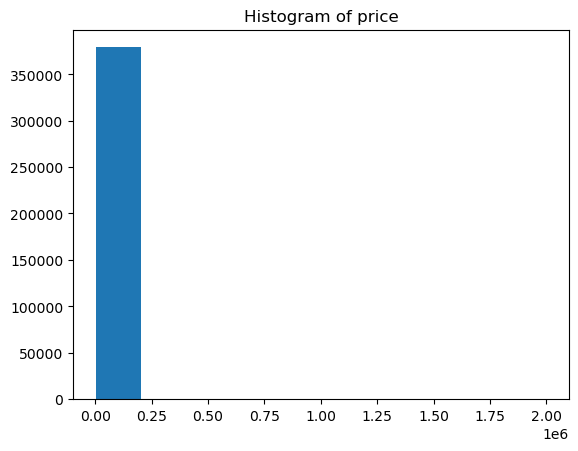

In [457]:
plt.hist(df['price'])
plt.title('Histogram of price')
#Heavily, skewed non-normal distribution

Text(0.5, 1.0, 'Histogram of log of price')

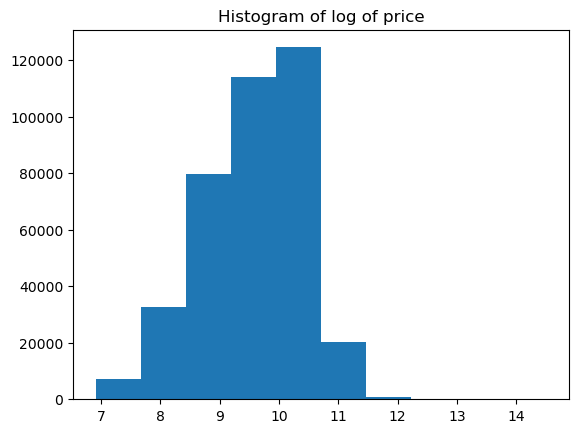

In [458]:
plt.hist(np.log(df['price']))
plt.title('Histogram of log of price')
# Taking the log makes the distribution better/more normal and less skewed, and also makes sense because of the large range

In [459]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 379323 entries, 0 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         379323 non-null  int64  
 1   year          378159 non-null  float64
 2   manufacturer  364335 non-null  object 
 3   model         374928 non-null  object 
 4   condition     236405 non-null  object 
 5   cylinders     224549 non-null  object 
 6   fuel          376732 non-null  object 
 7   odometer      377245 non-null  float64
 8   title_status  372771 non-null  object 
 9   transmission  377508 non-null  object 
 10  drive         264639 non-null  object 
 11  size          106905 non-null  object 
 12  type          298648 non-null  object 
 13  paint_color   271005 non-null  object 
 14  state         379323 non-null  object 
dtypes: float64(2), int64(1), object(12)
memory usage: 46.3+ MB


In [460]:
#Some variables/columns have very few missing values(<4%), so those corresponding rows will be dropped
df=df.dropna(subset=['year','odometer', 'manufacturer','model','fuel','title_status','transmission'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 349247 entries, 27 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         349247 non-null  int64  
 1   year          349247 non-null  float64
 2   manufacturer  349247 non-null  object 
 3   model         349247 non-null  object 
 4   condition     218722 non-null  object 
 5   cylinders     206545 non-null  object 
 6   fuel          349247 non-null  object 
 7   odometer      349247 non-null  float64
 8   title_status  349247 non-null  object 
 9   transmission  349247 non-null  object 
 10  drive         246173 non-null  object 
 11  size          99824 non-null   object 
 12  type          276149 non-null  object 
 13  paint_color   253707 non-null  object 
 14  state         349247 non-null  object 
dtypes: float64(2), int64(1), object(12)
memory usage: 42.6+ MB


In [461]:
df.isnull().sum()/(df.shape[0])*100

price            0.000000
year             0.000000
manufacturer     0.000000
model            0.000000
condition       37.373263
cylinders       40.859907
fuel             0.000000
odometer         0.000000
title_status     0.000000
transmission     0.000000
drive           29.513210
size            71.417364
type            20.930173
paint_color     27.355997
state            0.000000
dtype: float64

107
2018    29806
2017    29296
2013    25280
2015    25096
2014    24394
        ...  
1943        1
1921        1
1915        1
1905        1
1945        1
Name: year, Length: 107, dtype: int64


Text(0.5, 1.0, 'Histogram of years')

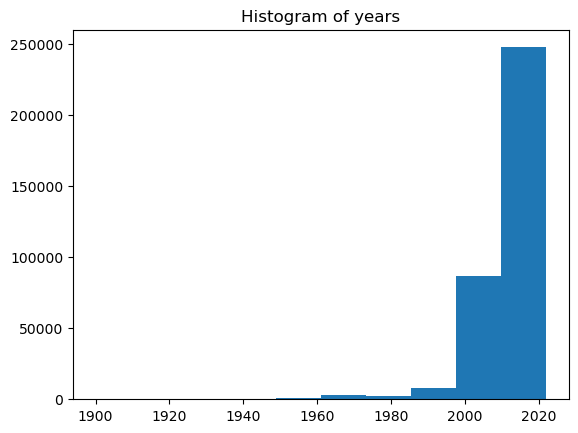

In [462]:
df['year']=df['year'].astype(int) #Years are converted to integers
print(df['year'].nunique())
print(df['year'].value_counts())
plt.hist((df['year']))
plt.title('Histogram of years')

In [463]:
df['odometer']=df['odometer'].astype(int)
print(df['odometer'].nunique())
print(df['odometer'].value_counts())

91583
1         1380
200000    1377
150000    1274
100000    1166
160000    1106
          ... 
206207       1
188667       1
212856       1
29509        1
69550        1
Name: odometer, Length: 91583, dtype: int64


In [464]:
df=df[(df['odometer'] > 1000)] #Keeping values b/w odometer thresholds that make sense for used cars in US(removing outliers)
df=df[(df['odometer'] < 500_000)]
df['odometer'].value_counts()

200000    1377
150000    1274
100000    1166
160000    1106
140000    1076
          ... 
198125       1
178264       1
143040       1
101935       1
69550        1
Name: odometer, Length: 90839, dtype: int64

Text(0.5, 1.0, 'Histogram of Odometer readings')

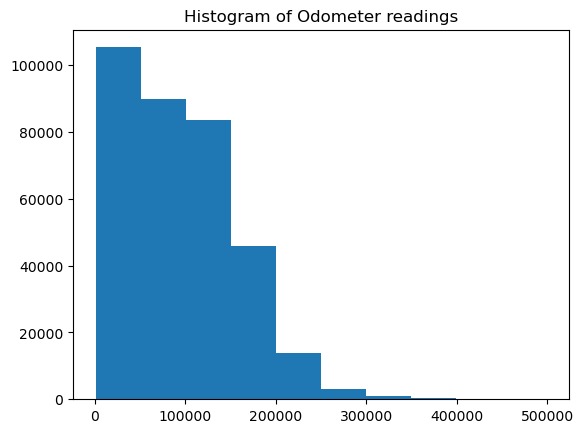

In [465]:
plt.hist(df['odometer'])
plt.title('Histogram of Odometer readings')

In [466]:
df.corr()

,price,year,odometer
price,1.000000,0.365722,-0.499607
year,0.365722,1.000000,-0.406400
odometer,-0.499607,-0.406400,1.000000


In [467]:
#df.info()
df['log_price']=np.log(df['price'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 342471 entries, 27 to 426879
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         342471 non-null  int64  
 1   year          342471 non-null  int32  
 2   manufacturer  342471 non-null  object 
 3   model         342471 non-null  object 
 4   condition     214799 non-null  object 
 5   cylinders     203227 non-null  object 
 6   fuel          342471 non-null  object 
 7   odometer      342471 non-null  int32  
 8   title_status  342471 non-null  object 
 9   transmission  342471 non-null  object 
 10  drive         242266 non-null  object 
 11  size          98320 non-null   object 
 12  type          271984 non-null  object 
 13  paint_color   249703 non-null  object 
 14  state         342471 non-null  object 
 15  log_price     342471 non-null  float64
dtypes: float64(1), int32(2), int64(1), object(12)
memory usage: 41.8+ MB


In [468]:
df.isnull().sum()/(df.shape[0])*100

price            0.000000
year             0.000000
manufacturer     0.000000
model            0.000000
condition       37.279653
cylinders       40.658625
fuel             0.000000
odometer         0.000000
title_status     0.000000
transmission     0.000000
drive           29.259412
size            71.291000
type            20.581889
paint_color     27.087841
state            0.000000
log_price        0.000000
dtype: float64

Next, all columns are examined with respect to price-this helps in understanding which variables have an impact on price    visually, and see if columns with 20-40% of missing values (condition,cylinders,drive,type,size) should be kept or removed or replaced. This also helps in deciding in finalizing predictors for the modelling step.

41
ford               59208
chevrolet          45415
toyota             28947
honda              18195
nissan             15595
jeep               15509
ram                14505
gmc                14136
bmw                12746
dodge              10586
mercedes-benz       9378
hyundai             8540
subaru              8297
volkswagen          8060
lexus               7260
kia                 6867
audi                6732
cadillac            5961
acura               5340
chrysler            5068
buick               4696
mazda               4614
infiniti            4242
lincoln             3741
volvo               2971
mitsubishi          2759
mini                2107
pontiac             2016
jaguar              1739
rover               1545
porsche             1186
mercury              977
saturn               971
alfa-romeo           845
tesla                768
fiat                 699
harley-davidson      100
ferrari               61
datsun                57
aston-martin          

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40]),
 [Text(0, 0, 'gmc'),
  Text(1, 0, 'chevrolet'),
  Text(2, 0, 'toyota'),
  Text(3, 0, 'ford'),
  Text(4, 0, 'jeep'),
  Text(5, 0, 'nissan'),
  Text(6, 0, 'ram'),
  Text(7, 0, 'mazda'),
  Text(8, 0, 'cadillac'),
  Text(9, 0, 'honda'),
  Text(10, 0, 'dodge'),
  Text(11, 0, 'lexus'),
  Text(12, 0, 'jaguar'),
  Text(13, 0, 'chrysler'),
  Text(14, 0, 'volvo'),
  Text(15, 0, 'audi'),
  Text(16, 0, 'infiniti'),
  Text(17, 0, 'lincoln'),
  Text(18, 0, 'alfa-romeo'),
  Text(19, 0, 'subaru'),
  Text(20, 0, 'acura'),
  Text(21, 0, 'hyundai'),
  Text(22, 0, 'buick'),
  Text(23, 0, 'mercedes-benz'),
  Text(24, 0, 'bmw'),
  Text(25, 0, 'mitsubishi'),
  Text(26, 0, 'volkswagen'),
  Text(27, 0, 'porsche'),
  Text(28, 0, 'kia'),
  Text(29, 0, 'ferrari'),
  Text(30, 0, 'mini'),
  Text(31, 0, 'pontiac'),
  Text(32, 0, 

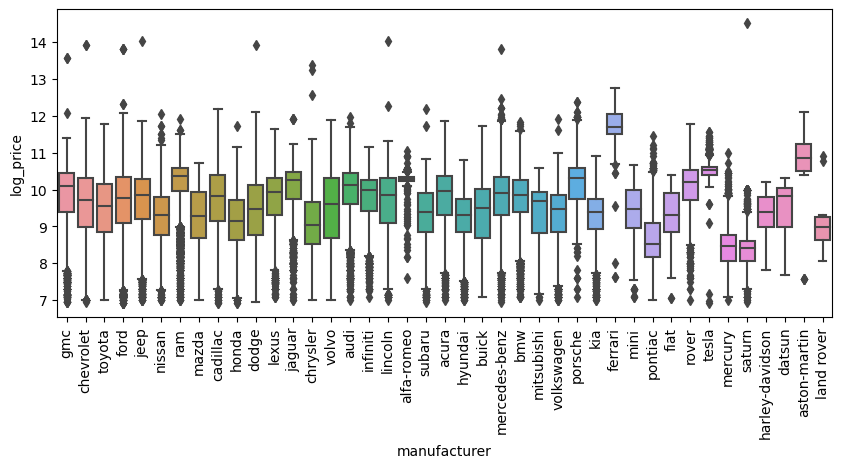

In [469]:
print(df['manufacturer'].nunique())
print(df['manufacturer'].value_counts())
plt.figure(figsize=(10,4))
sns.boxplot(data=df,x='manufacturer',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='manufacturer',y='log_price')
#Manufacturer does seem to have an impact on the prices

In [513]:
%%time
print(df['model'].nunique())
print(df['model'].value_counts())
plt.figure(figsize=(20,10))
#sns.boxplot(data=df,x='model',y='log_price')
#sns.lineplot(data=df, x="model", y="log_price")
#plt.xticks(rotation=90)
px.box(df,x='model',y='log_price')
#Model does seem to have an impact on the prices

19754
f-150                      6607
silverado 1500             4140
1500                       3554
camry                      2618
silverado                  2616
                           ... 
w300 powerwagon               1
captiva sport fleet lt        1
civic hybrid 4dr sdn l4       1
wrangler se 4wd               1
gand wagoneer                 1
Name: model, Length: 19754, dtype: int64
Wall time: 1.29 s


<Figure size 2000x1000 with 0 Axes>

6
good         110259
excellent     80946
like new      17725
fair           4922
new             612
salvage         335
Name: condition, dtype: int64


(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'good'),
  Text(1, 0, 'excellent'),
  Text(2, 0, 'fair'),
  Text(3, 0, 'like new'),
  Text(4, 0, 'new'),
  Text(5, 0, 'salvage')])

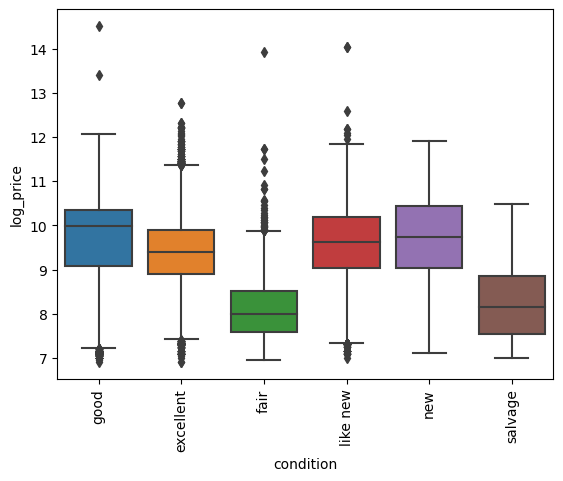

In [471]:
print(df['condition'].nunique())
print(df['condition'].value_counts())
sns.boxplot(data=df,x='condition',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='condition',y='log_price')
#Condition does seem to have an impact on the prices

8
6 cylinders     78090
4 cylinders     63010
8 cylinders     58432
5 cylinders      1434
10 cylinders     1045
other             703
3 cylinders       415
12 cylinders       98
Name: cylinders, dtype: int64


(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, '8 cylinders'),
  Text(1, 0, '6 cylinders'),
  Text(2, 0, '4 cylinders'),
  Text(3, 0, '5 cylinders'),
  Text(4, 0, '10 cylinders'),
  Text(5, 0, '3 cylinders'),
  Text(6, 0, 'other'),
  Text(7, 0, '12 cylinders')])

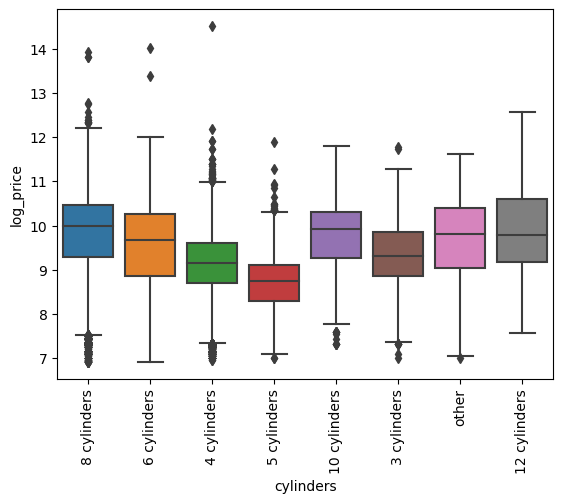

In [473]:
print(df['cylinders'].nunique())
print(df['cylinders'].value_counts())
sns.boxplot(data=df,x='cylinders',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='cylinders',y='log_price')
#Number of cylinders do seem to have an impact on the prices

5
gas         290085
other        25549
diesel       20903
hybrid        4513
electric      1421
Name: fuel, dtype: int64


(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'gas'),
  Text(1, 0, 'other'),
  Text(2, 0, 'diesel'),
  Text(3, 0, 'hybrid'),
  Text(4, 0, 'electric')])

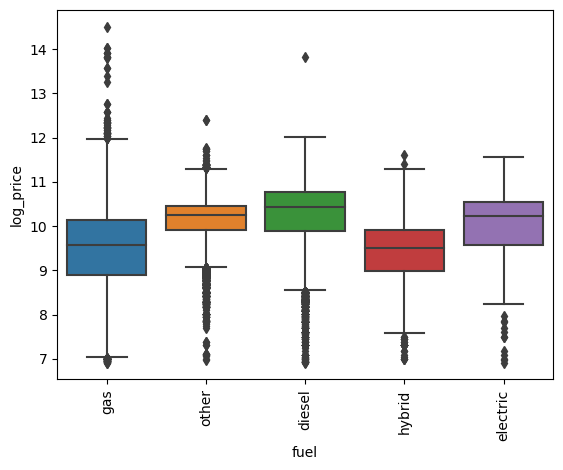

In [474]:
print(df['fuel'].nunique())
print(df['fuel'].value_counts())
sns.boxplot(data=df,x='fuel',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='fuel',y='log_price')
#MFuel seems to have an some impact on the prices

6
clean         330855
rebuilt         6563
salvage         3364
lien            1282
missing          350
parts only        57
Name: title_status, dtype: int64


(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'clean'),
  Text(1, 0, 'rebuilt'),
  Text(2, 0, 'lien'),
  Text(3, 0, 'salvage'),
  Text(4, 0, 'missing'),
  Text(5, 0, 'parts only')])

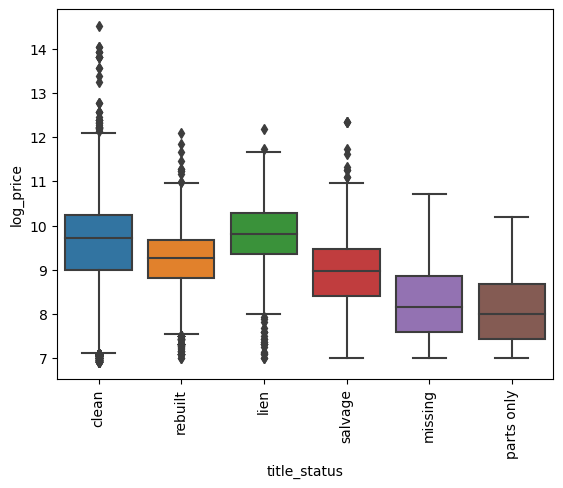

In [475]:
print(df['title_status'].nunique())
print(df['title_status'].value_counts())
sns.boxplot(data=df,x='title_status',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='title_status',y='log_price')
#Title_status does seem to have an impact on the prices

3
automatic    266939
other         57001
manual        18531
Name: transmission, dtype: int64


(array([0, 1, 2]),
 [Text(0, 0, 'other'), Text(1, 0, 'automatic'), Text(2, 0, 'manual')])

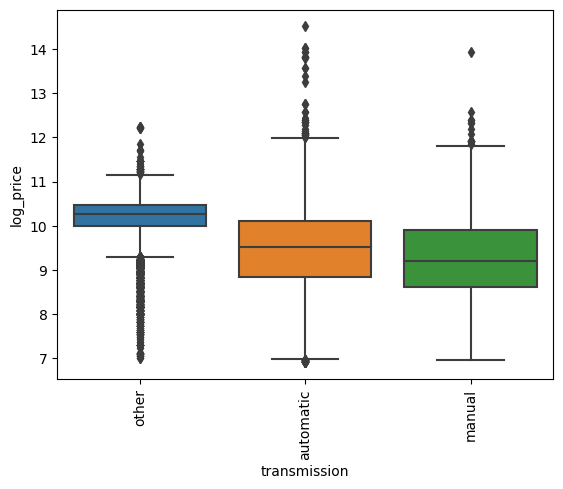

In [476]:
print(df['transmission'].nunique())
print(df['transmission'].value_counts())
sns.boxplot(data=df,x='transmission',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='transmission',y='log_price')
#Transmission does seem to have somewhat of an impact on the prices

3


(array([0, 1, 2]), [Text(0, 0, 'rwd'), Text(1, 0, '4wd'), Text(2, 0, 'fwd')])

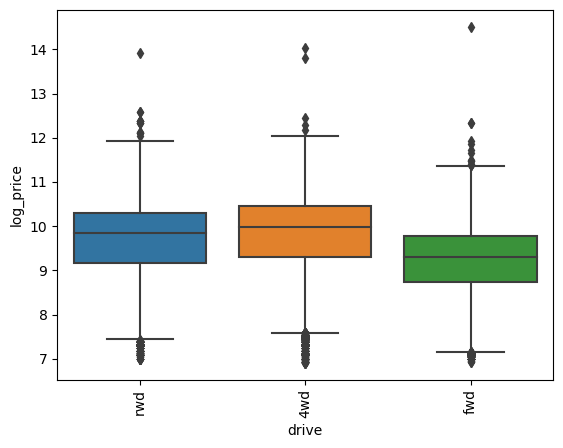

In [477]:
print(df['drive'].nunique())
df['drive'].value_counts()
sns.boxplot(data=df,x='drive',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='drive',y='log_price')
#Drive's impact on prices is low, but visible esp for low prices of fwd

4
full-size      51455
mid-size       29233
compact        15157
sub-compact     2475
Name: size, dtype: int64


(array([0, 1, 2, 3]),
 [Text(0, 0, 'full-size'),
  Text(1, 0, 'mid-size'),
  Text(2, 0, 'compact'),
  Text(3, 0, 'sub-compact')])

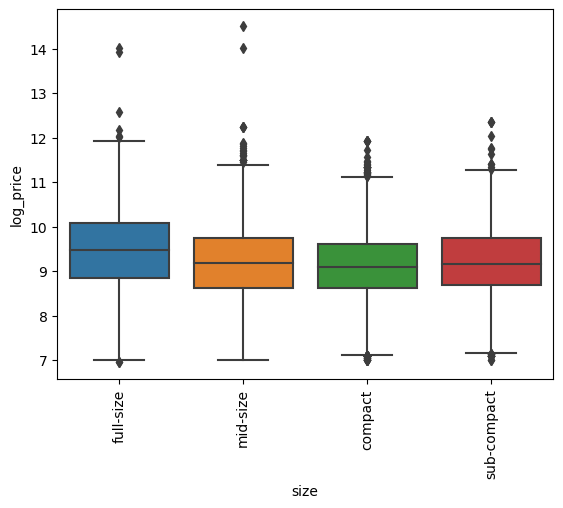

In [478]:
print(df['size'].nunique())
print(df['size'].value_counts())
sns.boxplot(data=df,x='size',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='size',y='log_price')
#Size has >70% of the data missing, so will be dropped. Besides, it maybe covered in the 'type' variable of this dataset

13
sedan          71357
SUV            62476
pickup         38116
truck          26245
other          17484
coupe          15302
hatchback      13935
wagon           9058
van             6728
convertible     6381
mini-van        4144
offroad          502
bus              256
Name: type, dtype: int64


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, 'pickup'),
  Text(1, 0, 'truck'),
  Text(2, 0, 'other'),
  Text(3, 0, 'coupe'),
  Text(4, 0, 'SUV'),
  Text(5, 0, 'hatchback'),
  Text(6, 0, 'mini-van'),
  Text(7, 0, 'sedan'),
  Text(8, 0, 'offroad'),
  Text(9, 0, 'convertible'),
  Text(10, 0, 'wagon'),
  Text(11, 0, 'van'),
  Text(12, 0, 'bus')])

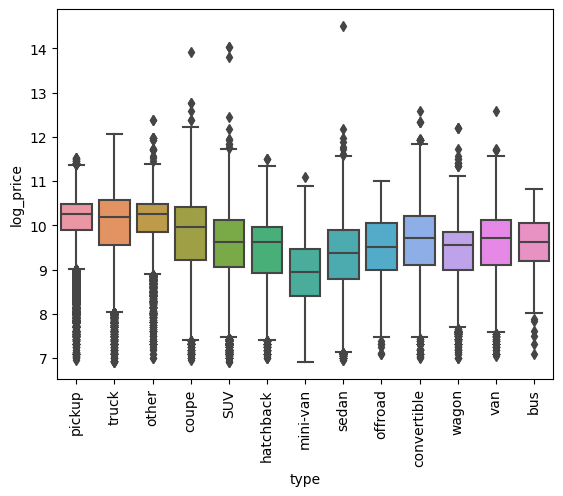

In [479]:
print(df['type'].nunique())
print(df['type'].value_counts())
sns.boxplot(data=df,x='type',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='type',y='log_price')
#Type does seem to have an impact on the prices

12


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 [Text(0, 0, 'white'),
  Text(1, 0, 'blue'),
  Text(2, 0, 'red'),
  Text(3, 0, 'black'),
  Text(4, 0, 'silver'),
  Text(5, 0, 'grey'),
  Text(6, 0, 'brown'),
  Text(7, 0, 'yellow'),
  Text(8, 0, 'orange'),
  Text(9, 0, 'green'),
  Text(10, 0, 'custom'),
  Text(11, 0, 'purple')])

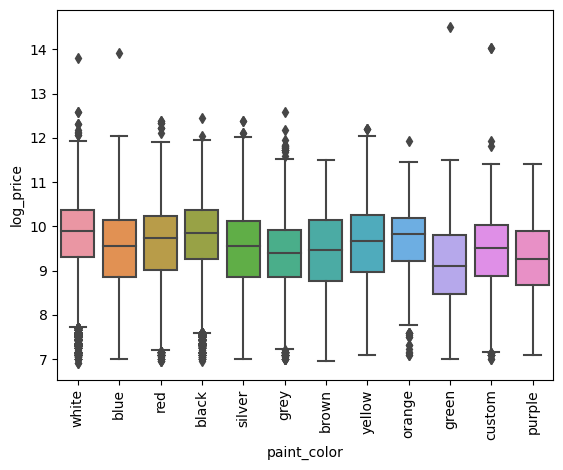

In [480]:
print(df['paint_color'].nunique())
df['paint_color'].value_counts()
sns.boxplot(data=df,x='paint_color',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='paint_color',y='log_price')
#Paint color does not seem to vary the prices much, so will be not considered a variable for modeling the price

51


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]),
 [Text(0, 0, 'al'),
  Text(1, 0, 'ak'),
  Text(2, 0, 'az'),
  Text(3, 0, 'ar'),
  Text(4, 0, 'ca'),
  Text(5, 0, 'co'),
  Text(6, 0, 'ct'),
  Text(7, 0, 'dc'),
  Text(8, 0, 'de'),
  Text(9, 0, 'fl'),
  Text(10, 0, 'ga'),
  Text(11, 0, 'hi'),
  Text(12, 0, 'id'),
  Text(13, 0, 'il'),
  Text(14, 0, 'in'),
  Text(15, 0, 'ia'),
  Text(16, 0, 'ks'),
  Text(17, 0, 'ky'),
  Text(18, 0, 'la'),
  Text(19, 0, 'me'),
  Text(20, 0, 'md'),
  Text(21, 0, 'ma'),
  Text(22, 0, 'mi'),
  Text(23, 0, 'mn'),
  Text(24, 0, 'ms'),
  Text(25, 0, 'mo'),
  Text(26, 0, 'mt'),
  Text(27, 0, 'nc'),
  Text(28, 0, 'ne'),
  Text(29, 0, 'nv'),
  Text(30, 0, 'nj'),
  Text(31, 0, 'nm'),
  Text(32, 0, 'ny'),
  Text(33, 0, 'nh'),
  Text(34, 0, 'nd'),
  Text(35, 0, 'oh'),
  Text(36, 0, 'ok'),
  T

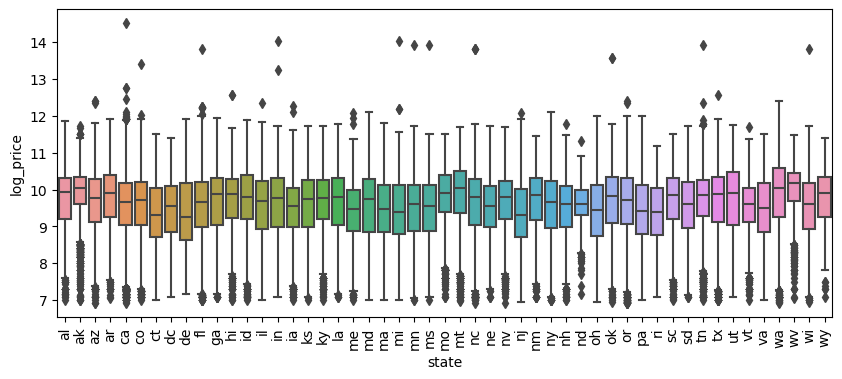

In [481]:
print(df['state'].nunique())
df['state'].value_counts()
plt.figure(figsize=(10,4))
sns.boxplot(data=df,x='state',y='log_price')
plt.xticks(rotation=90)
#px.box(df,x='state',y='log_price')
#A lot of data for states, does not seem like a strong impact on prices, perhaps small effect-
#so will be kept in the model for now

In [482]:
d=df.drop(columns=['size', 'paint_color']) # Size had >70% missing values & paint_color did not seem to impact prices
d.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 342471 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         342471 non-null  int64  
 1   year          342471 non-null  int32  
 2   manufacturer  342471 non-null  object 
 3   model         342471 non-null  object 
 4   condition     214799 non-null  object 
 5   cylinders     203227 non-null  object 
 6   fuel          342471 non-null  object 
 7   odometer      342471 non-null  int32  
 8   title_status  342471 non-null  object 
 9   transmission  342471 non-null  object 
 10  drive         242266 non-null  object 
 11  type          271984 non-null  object 
 12  state         342471 non-null  object 
 13  log_price     342471 non-null  float64
dtypes: float64(1), int32(2), int64(1), object(10)
memory usage: 36.6+ MB


In [483]:
d.isnull().sum()/(df.shape[0])*100

price            0.000000
year             0.000000
manufacturer     0.000000
model            0.000000
condition       37.279653
cylinders       40.658625
fuel             0.000000
odometer         0.000000
title_status     0.000000
transmission     0.000000
drive           29.259412
type            20.581889
state            0.000000
log_price        0.000000
dtype: float64

Condition, cylinders, drive, and type have >20% missing values. These missing values are imputed by filling NaNs with their respective modes.

In [484]:
d=d[d['cylinders']!='other']
d['cylinders'] = d['cylinders'].map({'12 cylinders': 12, '10 cylinders': 10,'8 cylinders':8,'6 cylinders':6,'5 cylinders':5,'4 cylinders':4,'3 cylinders':3})
print(d['cylinders'].mode())

0    6.0
Name: cylinders, dtype: float64


In [485]:
d['cylinders']=d['cylinders'].fillna(6) #Mode is 6 for cylinders, so fill NaNs with mode
#d['cylinders']=d['cylinders'].astype(int)
#print(d['cylinders'].value_counts())
d.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 341768 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         341768 non-null  int64  
 1   year          341768 non-null  int32  
 2   manufacturer  341768 non-null  object 
 3   model         341768 non-null  object 
 4   condition     214402 non-null  object 
 5   cylinders     341768 non-null  float64
 6   fuel          341768 non-null  object 
 7   odometer      341768 non-null  int32  
 8   title_status  341768 non-null  object 
 9   transmission  341768 non-null  object 
 10  drive         241660 non-null  object 
 11  type          271356 non-null  object 
 12  state         341768 non-null  object 
 13  log_price     341768 non-null  float64
dtypes: float64(2), int32(2), int64(1), object(9)
memory usage: 36.5+ MB


In [486]:
print(d['condition'].mode())
d['condition']=d['condition'].fillna('good')#fill nans with mode of 'good'
d.info()

0    good
Name: condition, dtype: object
<class 'pandas.core.frame.DataFrame'>
Int64Index: 341768 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         341768 non-null  int64  
 1   year          341768 non-null  int32  
 2   manufacturer  341768 non-null  object 
 3   model         341768 non-null  object 
 4   condition     341768 non-null  object 
 5   cylinders     341768 non-null  float64
 6   fuel          341768 non-null  object 
 7   odometer      341768 non-null  int32  
 8   title_status  341768 non-null  object 
 9   transmission  341768 non-null  object 
 10  drive         241660 non-null  object 
 11  type          271356 non-null  object 
 12  state         341768 non-null  object 
 13  log_price     341768 non-null  float64
dtypes: float64(2), int32(2), int64(1), object(9)
memory usage: 36.5+ MB


In [487]:
print(d['drive'].mode())
d['drive']=d['drive'].fillna('4wd')#fill nans with mode of '4wd'
d.info()

0    4wd
Name: drive, dtype: object
<class 'pandas.core.frame.DataFrame'>
Int64Index: 341768 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         341768 non-null  int64  
 1   year          341768 non-null  int32  
 2   manufacturer  341768 non-null  object 
 3   model         341768 non-null  object 
 4   condition     341768 non-null  object 
 5   cylinders     341768 non-null  float64
 6   fuel          341768 non-null  object 
 7   odometer      341768 non-null  int32  
 8   title_status  341768 non-null  object 
 9   transmission  341768 non-null  object 
 10  drive         341768 non-null  object 
 11  type          271356 non-null  object 
 12  state         341768 non-null  object 
 13  log_price     341768 non-null  float64
dtypes: float64(2), int32(2), int64(1), object(9)
memory usage: 36.5+ MB


In [488]:
print(d['type'].mode())
d['type']=d['type'].fillna('sedan')#fill nans with mode of 'sedan'
d.info()

0    sedan
Name: type, dtype: object
<class 'pandas.core.frame.DataFrame'>
Int64Index: 341768 entries, 27 to 426879
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         341768 non-null  int64  
 1   year          341768 non-null  int32  
 2   manufacturer  341768 non-null  object 
 3   model         341768 non-null  object 
 4   condition     341768 non-null  object 
 5   cylinders     341768 non-null  float64
 6   fuel          341768 non-null  object 
 7   odometer      341768 non-null  int32  
 8   title_status  341768 non-null  object 
 9   transmission  341768 non-null  object 
 10  drive         341768 non-null  object 
 11  type          341768 non-null  object 
 12  state         341768 non-null  object 
 13  log_price     341768 non-null  float64
dtypes: float64(2), int32(2), int64(1), object(9)
memory usage: 36.5+ MB


In [489]:
d.isnull().sum()/(df.shape[0])*100

price           0.0
year            0.0
manufacturer    0.0
model           0.0
condition       0.0
cylinders       0.0
fuel            0.0
odometer        0.0
title_status    0.0
transmission    0.0
drive           0.0
type            0.0
state           0.0
log_price       0.0
dtype: float64

In [490]:
d.corr() 
#Quick correlation matrix shows linear corr. for numerical variables, and correlations are better with log_price than price

,price,year,cylinders,odometer,log_price
price,1.000000,0.366031,0.238705,-0.499727,0.818071
year,0.366031,1.000000,-0.125188,-0.407070,0.484300
cylinders,0.238705,-0.125188,1.000000,0.030608,0.248266
odometer,-0.499727,-0.407070,0.030608,1.000000,-0.627736
log_price,0.818071,0.484300,0.248266,-0.627736,1.000000


### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

Data is segregated into predictors(X) and predictand(Y)

In [491]:
X=d.drop(columns=['price','log_price'])
y=d['log_price']
print(X.info())
X.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 341768 entries, 27 to 426879
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          341768 non-null  int32  
 1   manufacturer  341768 non-null  object 
 2   model         341768 non-null  object 
 3   condition     341768 non-null  object 
 4   cylinders     341768 non-null  float64
 5   fuel          341768 non-null  object 
 6   odometer      341768 non-null  int32  
 7   title_status  341768 non-null  object 
 8   transmission  341768 non-null  object 
 9   drive         341768 non-null  object 
 10  type          341768 non-null  object 
 11  state         341768 non-null  object 
dtypes: float64(1), int32(2), object(9)
memory usage: 31.3+ MB
None


,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,state
27,2014,gmc,sierra 1500 crew cab slt,good,8.0,gas,57923,clean,other,4wd,pickup,al
28,2010,chevrolet,silverado 1500,good,8.0,gas,71229,clean,other,4wd,pickup,al
29,2020,chevrolet,silverado 1500 crew,good,8.0,gas,19160,clean,other,4wd,pickup,al
30,2017,toyota,tundra double cab sr,good,8.0,gas,41124,clean,other,4wd,pickup,al
31,2013,ford,f-150 xlt,excellent,6.0,gas,128000,clean,automatic,rwd,truck,al


The predictors data primarily contains categorical variables that are believed to have major impact on price. Category encoders are considered for use, and the JamesSteins Encoder is employed. But prior to encoding, the data is split into train and test for **hold-out cross validation**. Since there is sufficient data, this method of cross-validation would be sufficient for model accuracy evaluation, however, at the end of this code, additional k-fold validation is also performed. Since the encoding ustilizes the target feature, the encoder is fit on training dataset and then the test data is transformed accordingly.

In [492]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size = 0.2, random_state=32)
enc=ce.james_stein.JamesSteinEncoder(return_df=True)
X_train_enc=enc.fit_transform(X_train,y_train)
X_test_enc=enc.transform(X_test)
X_train_enc

,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,state
160528,2013,9.598959,9.513117,9.446466,8.0,9.505407,105000,9.590047,9.470013,9.703205,9.566923,9.513268
190456,2005,8.859819,8.253922,9.644343,6.0,9.505407,145820,9.590047,9.470013,9.703205,9.431696,9.497796
65726,2015,9.395315,8.939097,9.446466,4.0,9.505407,92711,9.590047,9.470013,9.703205,9.501162,9.579871
18013,2016,9.598959,10.491135,9.644343,8.0,10.065710,102540,9.590047,9.470013,9.703205,9.951158,9.677446
182991,2011,9.627417,9.321222,9.644343,6.0,9.505407,171701,9.590047,10.202871,9.703205,9.566923,9.555722
...,...,...,...,...,...,...,...,...,...,...,...,...
353333,2017,9.967429,10.068993,9.644343,8.0,9.505407,78951,9.590047,9.470013,9.703205,9.941209,9.650254
402474,2008,9.755068,9.548760,9.644343,8.0,9.505407,175582,9.590047,9.470013,9.703205,9.566923,9.715161
95347,2015,9.398508,9.235829,9.446466,4.0,9.505407,85386,9.590047,9.470013,9.228893,9.431696,9.566083
164308,2013,9.323436,8.640692,9.644343,4.0,9.505407,94000,9.312976,9.470013,9.703205,9.431696,9.590899


<AxesSubplot:>

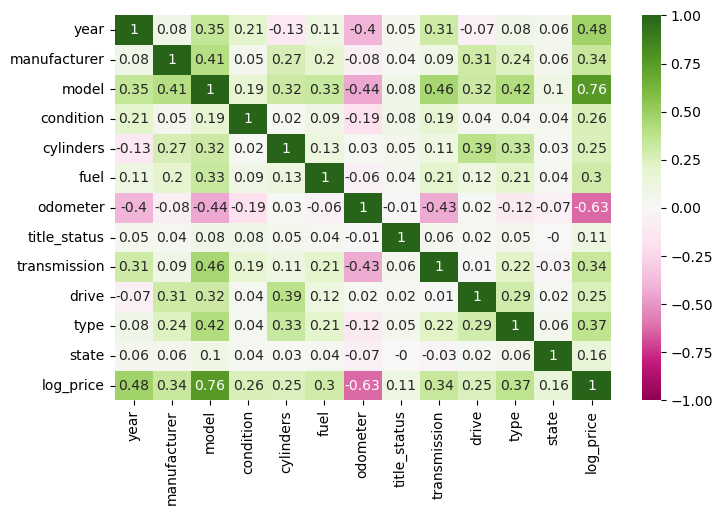

In [493]:
X_train_enc['log_price']=y_train
fig = plt.figure(figsize=(8,5))
sns.heatmap(round(X_train_enc.corr(),2),vmin=-1,vmax=1,cmap='PiYG',annot=True)
# A quick heatmap to vizualize correlation of different encoded variables with log_price. 
# It is clear that model, odometer, year have the highest correlations, followed by type, transmission, and manufacturer.
# There is some multicollinearity too as some variabels are correlated with each other, 
# so regression models like ridge and lasso that can handle multicollinearity will be employed later (after a baseline model)

In [494]:
X_train_enc=X_train_enc.drop(columns=['log_price'])
X_train_enc.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 273414 entries, 160528 to 13043
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          273414 non-null  int32  
 1   manufacturer  273414 non-null  float64
 2   model         273414 non-null  float64
 3   condition     273414 non-null  float64
 4   cylinders     273414 non-null  float64
 5   fuel          273414 non-null  float64
 6   odometer      273414 non-null  int32  
 7   title_status  273414 non-null  float64
 8   transmission  273414 non-null  float64
 9   drive         273414 non-null  float64
 10  type          273414 non-null  float64
 11  state         273414 non-null  float64
dtypes: float64(10), int32(2)
memory usage: 25.0 MB


To start off, a baseline regression model is run with simple linear regression

    1. Simple Linear Regression

In [420]:
#simple_lin_reg=LinearRegression()
simple_lin_reg_pipe = Pipeline([('scaler', StandardScaler()),('lr', LinearRegression())])
simple_lin_reg_pipe.fit(X_train_enc,y_train)
slr_train_preds = simple_lin_reg_pipe.predict(X_train_enc)
slr_test_preds = simple_lin_reg_pipe.predict(X_test_enc)
slr_train_mse = mean_squared_error(y_train, slr_train_preds)
slr_test_mse = mean_squared_error(y_test, slr_test_preds)
slr_train_r2=r2_score(y_train, slr_train_preds)
slr_test_r2=r2_score(y_test,slr_test_preds)
print(slr_train_mse)
print(slr_train_r2)
print('=================')
print('Test/Validation MSE and R2:')
print(slr_test_mse)
print((slr_test_r2))

slr_coefs=simple_lin_reg_pipe.named_steps['lr'].coef_
slr_df=pd.DataFrame(columns=['features', 'slr_coefs'])
slr_df['slr_coefs']=slr_coefs
slr_df['features']=X_train_enc.columns
slr_df
slr_df.loc[slr_df['slr_coefs'] != 0].sort_values(by='slr_coefs',ascending=False,key=abs)
# The baseline simple linear regression has a validation MSE of 0.17 and R2 of appx. 75%, 
# which is pretty good for a basic model. Since the data was standardized before running the model, the features with 
# highest coefficients are shown are are: model, odometer, year, transmission, fuel, and cylinders (top 6 features)

0.16377750393128238
0.7602057523539327
Test/Validation MSE and R2:
0.17277911069478444
0.7464914187813887


,features,slr_coefs
2,model,0.375352
6,odometer,-0.320480
0,year,0.156525
8,transmission,-0.125945
5,fuel,0.074382
4,cylinders,0.069420
10,type,0.059994
3,condition,0.054098
11,state,0.048140
7,title_status,0.044748


    2. Polynomial Regression

In [414]:
pipe = Pipeline([('poly', PolynomialFeatures(include_bias=False)),('scaler', StandardScaler()),('lr', LinearRegression())])
param = {'poly__degree' : [1,2,3]}#Higher orders were too computationally expensive to run,& led to minimal reduction in MSE
grid = GridSearchCV(estimator = pipe,
                      param_grid = param,
                      scoring = 'neg_mean_squared_error')#, return_train_score = True)
grid.fit(X_train_enc,y_train)
train_preds = grid.predict(X_train_enc)
test_preds = grid.predict(X_test_enc)
train_mse = mean_squared_error(y_train, train_preds)
test_mse = mean_squared_error(y_test, test_preds)
print(train_mse)
print(test_mse)
print(grid.best_estimator_)
best_poly=grid.best_estimator_.named_steps['poly']
print(best_poly)
feats=grid.best_estimator_.named_steps['poly'].get_feature_names_out()
#print(feats)
p_coefs = grid.best_estimator_.named_steps['lr'].coef_
#print(p_coefs)
reg_df=pd.DataFrame(columns=['features', 'coefs'])
reg_df['coefs']=p_coefs
reg_df['features']=feats
reg_df
reg_df.loc[reg_df['coefs'] != 0].sort_values(by='coefs',ascending=False,key=abs).head(15)
# The best polynomial regression with degree=3 (degree 4 gave an error similar to degree 3 but was way 
# more computationally expensive) has a validation MSE of 0.12 and the top features with highest coefficients are shown below.
# These are usually some function/order of fuel, year, drive, odometer, model, and type.

0.11163469209835343
0.11948815090350318
Pipeline(steps=[('poly', PolynomialFeatures(degree=3, include_bias=False)),
                ('scaler', StandardScaler()), ('lr', LinearRegression())])
PolynomialFeatures(degree=3, include_bias=False)


,features,coefs
62,fuel^2,-2821.274720
140,year fuel^2,2759.694225
12,year^2,-2654.147842
17,year fuel,-2452.438795
5,fuel,2373.337609
162,year drive^2,-1967.141749
85,drive type,-1899.448226
86,drive state,-1687.306765
0,year,1554.716069
14,year model,1539.546063


    3. SFS-based Regression with Polynomial Features (GridSearchCV to find optimal no of features)

In [421]:
selector_pipe = Pipeline([('poly', PolynomialFeatures(degree=3, include_bias=False)),('scaler', StandardScaler()),\
                         ('selector', SequentialFeatureSelector(LinearRegression())),('lr', LinearRegression())])
selector_pipe
selector_param = {'selector__n_features_to_select': [1, 2, 3, 4, 5]} # it was limited to 5 as higher than 5 took >1hr to run
selector_grid = GridSearchCV(estimator=selector_pipe, param_grid=selector_param,\
                                     scoring = 'neg_mean_squared_error')
selector_grid.fit(X_train_enc, y_train)
selector_train_preds = selector_grid.predict(X_train_enc)
selector_test_preds = selector_grid.predict(X_test_enc)
selector_train_mse = mean_squared_error(y_train, selector_train_preds)
selector_test_mse = mean_squared_error(y_test, selector_test_preds)
print(selector_train_mse)
print(selector_test_mse)

best_estimator = selector_grid.best_estimator_
best_selector = best_estimator.named_steps['selector']
best_model = selector_grid.best_estimator_.named_steps['lr']
#feature_names = X_train.columns[best_selector.get_support()]
#print(feature_names)
coefs = best_model.coef_
print(coefs)
columns = selector_grid.best_estimator_.named_steps['poly'].get_feature_names_out()
#print(columns)
feature_names = columns[best_selector.get_support()]
print(feature_names)
sfs_df=pd.DataFrame(columns=['features', 'sfs_reg_coefs'])
sfs_df['sfs_reg_coefs']=coefs
sfs_df['features']=feature_names
sfs_df
sfs_df.loc[sfs_df['sfs_reg_coefs'] != 0].sort_values(by='sfs_reg_coefs',ascending=False,key=abs)
# The SFS-based polynomial regression has a validation MSE of 0.18, and top 5 features selected are shown below

0.17422461822531507
0.18397621677123333
[ 0.42735119  0.09401482  0.10318545  1.5735159  -1.8480481 ]
['year^2 model' 'year^2 title_status' 'condition drive state'
 'fuel odometer type' 'odometer transmission^2']


,features,sfs_reg_coefs
4,odometer transmission^2,-1.848048
3,fuel odometer type,1.573516
0,year^2 model,0.427351
2,condition drive state,0.103185
1,year^2 title_status,0.094015


    4. Ridge Regression with GridSearchCV to find optimal hyperparameter alpha

In [404]:
ridge_pipe = Pipeline([('poly', PolynomialFeatures(degree=3, include_bias=False)),\
                         ('scaler', StandardScaler()),('ridge', Ridge())])
ridge_param = {'ridge__alpha': [0.001,0.01,0.1,1,10,100]}
ridge_grid = GridSearchCV(ridge_pipe, param_grid=ridge_param,scoring = 'neg_mean_squared_error')
ridge_grid.fit(X_train_enc, y_train)
ridge_train_preds = ridge_grid.predict(X_train_enc)
ridge_test_preds = ridge_grid.predict(X_test_enc)
ridge_train_mse = mean_squared_error(y_train, ridge_train_preds)
ridge_test_mse = mean_squared_error(y_test, ridge_test_preds)
print(ridge_grid.best_estimator_)
print(ridge_train_mse)
print(ridge_test_mse)
ridge_coefs = ridge_grid.best_estimator_.named_steps['ridge'].coef_
#print(ridge_coefs)
feats=ridge_grid.best_estimator_.named_steps['poly'].get_feature_names_out()
#print(feats)
ridge_df=pd.DataFrame(columns=['features', 'ridge_coefs'])
ridge_df['ridge_coefs']=ridge_coefs
ridge_df['features']=feats
ridge_df
ridge_df.loc[ridge_df['ridge_coefs'] != 0].sort_values(by='ridge_coefs',ascending=False,key=abs).head(15)
#The ridge regression model run with degree 3 polynomial features selected optimal hyperparameter alpha of 0.001, and the
# Validation MSE is about 0.12. The top features with their cofficients are shown below, and are a function or some higher 
# order or interaction term including year, odometer, model, type, drive, and condition.

Pipeline(steps=[('poly', PolynomialFeatures(degree=3, include_bias=False)),
                ('scaler', StandardScaler()), ('ridge', Ridge(alpha=0.001))])
0.11726640236397813
0.125469005059569


,features,ridge_coefs
90,year^3,242.340976
12,year^2,-190.348784
96,year^2 odometer,149.427437
35,model^2,147.685004
450,type^3,-125.450890
150,year odometer drive,-111.587181
113,year model^2,-107.524770
101,year^2 state,-105.796765
165,year type^2,102.926139
123,year condition^2,99.006768


    5. Lasso Regression with GrisSearchCV to find optimal hyperparameter alpha

In [408]:
lasso_pipe = Pipeline([('poly', PolynomialFeatures(degree=3, include_bias=False)),\
                         ('scaler', StandardScaler()),('lasso', Lasso(random_state=42))])
lasso_pipe.fit(X_train_enc,y_train)
lasso_param = {'lasso__alpha': [0.001,0.01,0.1,1,10,100]}
lasso_grid = GridSearchCV(lasso_pipe, param_grid=lasso_param,scoring = 'neg_mean_squared_error')
lasso_grid.fit(X_train_enc, y_train)
lasso_train_preds = lasso_grid.predict(X_train_enc)
lasso_test_preds = lasso_grid.predict(X_test_enc)
lasso_train_mse = mean_squared_error(y_train, lasso_train_preds)
lasso_test_mse = mean_squared_error(y_test, lasso_test_preds)
print(lasso_grid.best_estimator_)
print(lasso_train_mse)
print(lasso_test_mse)
lasso_coefs=lasso_grid.best_estimator_.named_steps['lasso'].coef_
best_estimator = lasso_grid.best_estimator_
best_model = lasso_grid.best_estimator_.named_steps['lasso']
print(best_model)
feature_names = lasso_pipe.named_steps['poly'].get_feature_names_out()
lasso_df = pd.DataFrame({'features': feature_names, 'lasso_coef': lasso_coefs})
lasso_df
lasso_df.loc[lasso_df['lasso_coef'] != 0].sort_values(by='lasso_coef',ascending=False,key=abs).head(15)
# #The LASSO regression model run with degree 3 polynomial features selected optimal hyperparameter alpha of 0.001, and the
# Validation MSE is about 0.16. The top features with their cofficients are shown below.

Pipeline(steps=[('poly', PolynomialFeatures(degree=3, include_bias=False)),
                ('scaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.001, random_state=42))])
0.1547745504710647
0.16328182168481958
Lasso(alpha=0.001, random_state=42)


,features,lasso_coef
404,odometer title_status^2,-0.504603
6,odometer,-0.448785
289,condition^3,-0.401716
238,model^2 odometer,0.312571
371,fuel^2 odometer,0.252040
36,model condition,0.207861
3,condition,0.171235
90,year^3,0.155499
262,model fuel odometer,0.125340
388,fuel transmission^2,-0.121955


    6. Lasso-based SFS and Polynomial Regression (GridSearchCV to find optimal no of features)

In [495]:
selector_pipe = Pipeline([('poly', PolynomialFeatures(degree=2, include_bias=False)),('scaler', StandardScaler()),\
                         ('selector', SequentialFeatureSelector(Lasso(alpha=0.001))),('lr', LinearRegression())]) 
#Could not run degree 3 poly model in 1 hour, so quit that run and decreased the degree to 2 to save time
selector_pipe
selector_param = {'selector__n_features_to_select': [1, 2, 3, 4, 5]}
selector_grid = GridSearchCV(estimator=selector_pipe, param_grid=selector_param,\
                                     scoring = 'neg_mean_squared_error')
selector_grid.fit(X_train_enc, y_train)
selector_train_preds = selector_grid.predict(X_train_enc)
selector_test_preds = selector_grid.predict(X_test_enc)
selector_train_mse = mean_squared_error(y_train, selector_train_preds)
selector_test_mse = mean_squared_error(y_test, selector_test_preds)
print(selector_train_mse)
print(selector_test_mse)

best_estimator = selector_grid.best_estimator_
best_selector = best_estimator.named_steps['selector']
best_model = selector_grid.best_estimator_.named_steps['lr']
#feature_names = X_train.columns[best_selector.get_support()]
#print(feature_names)
coefs = best_model.coef_
print(coefs)
columns = selector_grid.best_estimator_.named_steps['poly'].get_feature_names_out()
#print(columns)
feature_names = columns[best_selector.get_support()]
print(feature_names)
sfs_df=pd.DataFrame(columns=['features', 'sfs_reg_coefs'])
sfs_df['sfs_reg_coefs']=coefs
sfs_df['features']=feature_names
sfs_df
sfs_df.loc[sfs_df['sfs_reg_coefs'] != 0].sort_values(by='sfs_reg_coefs',ascending=False,key=abs)
# The Lasso-based SFS polynomial regression has a validation MSE of 0.19, and top 5 features selected are shown below

0.17878314585040633
0.190621694992255
[ 1.35694319  0.38425166 -1.18750824  0.1271379  -0.30597694]
['year model' 'year transmission' 'model transmission' 'fuel type'
 'odometer transmission']


,features,sfs_reg_coefs
0,year model,1.356943
2,model transmission,-1.187508
1,year transmission,0.384252
4,odometer transmission,-0.305977
3,fuel type,0.127138


### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

Below are the Validation MSEs of the 6 models run above:
1. Simple Linear Regression : 0.17
2. Polynomial Regression : 0.12
3. SFS-based Polynomial Regression : 0.18
4. Ridge Regression : 0.12
5. Lasso regression : 0.16
6. Lasso-based SFS Polynomial Regression: 0.19

Based on the hold-out validation method, validation MSEs are lowest in the 1. Polynomial regression of degree 3 model and      2. Ridge regression with polynomial degree 3 and alpha 0.001. Of these two, Ridge regression was more computationally efficient.

Code below shows Permutation Importance of 1. Polynomial Regression (degree =3) and 2. Ridge Regression (degree=3 , alpha=0.001)

   1. Polynomial Regression (degree=3)

In [415]:
import eli5
from eli5.sklearn import PermutationImportance
perm = PermutationImportance(grid, random_state=0, scoring='r2').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.3356 ± 0.0050,model
0.2856 ± 0.0031,year
0.1407 ± 0.0022,odometer
0.0319 ± 0.0005,fuel
0.0235 ± 0.0008,condition
0.0235 ± 0.0006,cylinders
0.0224 ± 0.0009,transmission
0.0210 ± 0.0004,type
0.0180 ± 0.0010,drive
0.0103 ± 0.0002,title_status


In [416]:
perm = PermutationImportance(grid, random_state=0, scoring='neg_mean_squared_error').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.2287 ± 0.0034,model
0.1946 ± 0.0021,year
0.0959 ± 0.0015,odometer
0.0217 ± 0.0004,fuel
0.0160 ± 0.0005,condition
0.0160 ± 0.0004,cylinders
0.0152 ± 0.0006,transmission
0.0143 ± 0.0003,type
0.0123 ± 0.0007,drive
0.0070 ± 0.0001,title_status


In [417]:
perm = PermutationImportance(grid, random_state=0, scoring='neg_mean_absolute_percentage_error').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.0219 ± 0.0002,model
0.0193 ± 0.0001,year
0.0108 ± 0.0001,odometer
0.0026 ± 0.0001,transmission
0.0024 ± 0.0001,fuel
0.0024 ± 0.0001,cylinders
0.0019 ± 0.0000,type
0.0017 ± 0.0000,condition
0.0017 ± 0.0001,drive
0.0008 ± 0.0000,title_status


   2. Ridge Regression (degree=3 , alpha=0.001)

In [405]:
import eli5
from eli5.sklearn import PermutationImportance
perm = PermutationImportance(ridge_grid, random_state=0, scoring='r2').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.3670 ± 0.0057,model
0.2178 ± 0.0030,year
0.1763 ± 0.0025,odometer
0.0285 ± 0.0005,fuel
0.0279 ± 0.0008,condition
0.0238 ± 0.0004,cylinders
0.0193 ± 0.0006,type
0.0190 ± 0.0003,transmission
0.0148 ± 0.0010,drive
0.0096 ± 0.0003,title_status


In [406]:
perm = PermutationImportance(ridge_grid, random_state=0, scoring='neg_mean_squared_error').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.2501 ± 0.0039,model
0.1484 ± 0.0021,year
0.1201 ± 0.0017,odometer
0.0194 ± 0.0004,fuel
0.0190 ± 0.0006,condition
0.0162 ± 0.0003,cylinders
0.0132 ± 0.0004,type
0.0130 ± 0.0002,transmission
0.0101 ± 0.0007,drive
0.0066 ± 0.0002,title_status


In [407]:
perm = PermutationImportance(ridge_grid, random_state=0, scoring='neg_mean_absolute_percentage_error').fit(X_test_enc, y_test)
eli5.show_weights(perm, feature_names = X_test_enc.columns.tolist())

Weight,Feature
0.0233 ± 0.0002,model
0.0162 ± 0.0001,year
0.0129 ± 0.0001,odometer
0.0024 ± 0.0000,transmission
0.0023 ± 0.0001,cylinders
0.0022 ± 0.0001,fuel
0.0018 ± 0.0000,type
0.0018 ± 0.0000,condition
0.0013 ± 0.0001,drive
0.0008 ± 0.0000,title_status


K-fold validation: Since Ridge model is more computationally efficient, additional K-fold validation is performed on it

In [512]:
kf=KFold(n_splits=5,random_state=42,shuffle=True)
kf_test_mse =[]
kf_test_r2=[]

encoder = ce.james_stein.JamesSteinEncoder(return_df=True)

# Loop over the folds
for train_index, test_index in kf.split(X):
    # Get the training and test data for this fold
    X_trainKF, X_testKF = X.iloc[train_index], X.iloc[test_index]
    y_trainKF, y_testKF = y.iloc[train_index], y.iloc[test_index]

    # Fit the encoder on the training data for this fold only
    encoder.fit(X_trainKF, y_trainKF)

    # Encode the categorical variables in the training and the test data
    X_train_encodedKF = encoder.transform(X_trainKF)
    X_test_encodedKF = encoder.transform(X_testKF)

    # Fit the ridge model on the encoded training data
    ridge_grid.best_estimator_.fit(X_train_encodedKF, y_trainKF)
    
    # Make predictions on the encoded test data
    y_predKF = ridge_grid.best_estimator_.predict(X_test_encodedKF)

    # Calculate the test MSE and R2 for this fold
    kf_test_mse.append(mean_squared_error(y_testKF, y_predKF))
    kf_test_r2.append(r2_score(y_testKF, y_predKF))

print(np.mean(kf_test_mse))
print(np.mean(kf_test_r2))

#This k-fold cross validation MSE of 0.127 is similar to hold-out cross validation of 0.125 in case of the best 
# and one of the most computationally efficient Ridge model. The R2 of this best model is 81.3%.

0.12742170655424506
0.8133558973877155


### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

From permutation importance of best models, the following are the top variables (in order) that determine the price of a used car and can be informed to the client/used car dealer:
- Model
- Year
- Odometer
- Fuel
- Condition
- Cylinders (number of cylinders)
- Transmission & Type